# Workshop 1: Parkinson Telemonitoring

### Goals
- Strengthen student knowledge in descriptive statistics.
- Strengthen student knowledge acquired in machine learning techniques and algorithms.
- Generate skills in the use of modeling and programming tools for machine learning.

# Data Exploration

## Load dataset
From [UCI Machine Learning Repository](https://archive.ics.uci.edu/ml/datasets/Parkinsons+Telemonitoring), we load the dataset Parkinsons Telemonitoring. This dataset is composed of a range of biomedical voice measurements from 42 people with early-stage Parkinson's disease recruited to a six-month trial of a telemonitoring device for remote symptom progression monitoring.

The main aim of the data is to predict the motor and total UPDRS scores ('motor_UPDRS' and 'total_UPDRS') from the 16 voice measures. Since the prediction is a numeric value, we face a **regression problem**.

In [2]:
import pandas as pd

# Read dataset
# df = pd.read_csv("https://archive.ics.uci.edu/ml/machine-learning-databases/parkinsons/telemonitoring/parkinsons_updrs.data")
df = pd.read_csv("/content/parkinsons_updrs.data")
df

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,...,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,1,72,0,5.6431,28.199,34.398,0.00662,0.000034,0.00401,0.00317,...,0.230,0.01438,0.01309,0.01662,0.04314,0.014290,21.640,0.41888,0.54842,0.16006
1,1,72,0,12.6660,28.447,34.894,0.00300,0.000017,0.00132,0.00150,...,0.179,0.00994,0.01072,0.01689,0.02982,0.011112,27.183,0.43493,0.56477,0.10810
2,1,72,0,19.6810,28.695,35.389,0.00481,0.000025,0.00205,0.00208,...,0.181,0.00734,0.00844,0.01458,0.02202,0.020220,23.047,0.46222,0.54405,0.21014
3,1,72,0,25.6470,28.905,35.810,0.00528,0.000027,0.00191,0.00264,...,0.327,0.01106,0.01265,0.01963,0.03317,0.027837,24.445,0.48730,0.57794,0.33277
4,1,72,0,33.6420,29.187,36.375,0.00335,0.000020,0.00093,0.00130,...,0.176,0.00679,0.00929,0.01819,0.02036,0.011625,26.126,0.47188,0.56122,0.19361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5870,42,61,0,142.7900,22.485,33.485,0.00406,0.000031,0.00167,0.00168,...,0.160,0.00973,0.01133,0.01549,0.02920,0.025137,22.369,0.64215,0.55314,0.21367
5871,42,61,0,149.8400,21.988,32.988,0.00297,0.000025,0.00119,0.00147,...,0.215,0.01052,0.01277,0.01904,0.03157,0.011927,22.886,0.52598,0.56518,0.12621
5872,42,61,0,156.8200,21.495,32.495,0.00349,0.000025,0.00152,0.00187,...,0.244,0.01371,0.01456,0.01877,0.04112,0.017701,25.065,0.47792,0.57888,0.14157
5873,42,61,0,163.7300,21.007,32.007,0.00281,0.000020,0.00128,0.00151,...,0.131,0.00693,0.00870,0.01307,0.02078,0.007984,24.422,0.56865,0.56327,0.14204


## Describe dataset composition and each variable

Some info about the dataset, like data types, size and more.

In [3]:
# dataset composition
df.info()
# each variable description
df.describe().transpose()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5875 entries, 0 to 5874
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   subject#       5875 non-null   int64  
 1   age            5875 non-null   int64  
 2   sex            5875 non-null   int64  
 3   test_time      5875 non-null   float64
 4   motor_UPDRS    5875 non-null   float64
 5   total_UPDRS    5875 non-null   float64
 6   Jitter(%)      5875 non-null   float64
 7   Jitter(Abs)    5875 non-null   float64
 8   Jitter:RAP     5875 non-null   float64
 9   Jitter:PPQ5    5875 non-null   float64
 10  Jitter:DDP     5875 non-null   float64
 11  Shimmer        5875 non-null   float64
 12  Shimmer(dB)    5875 non-null   float64
 13  Shimmer:APQ3   5875 non-null   float64
 14  Shimmer:APQ5   5875 non-null   float64
 15  Shimmer:APQ11  5875 non-null   float64
 16  Shimmer:DDA    5875 non-null   float64
 17  NHR            5875 non-null   float64
 18  HNR     

,count,mean,std,min,25%,50%,75%,max
subject#,5875.0,21.494128,12.372279,1.000000,10.000000,22.000000,33.000000,42.000000
age,5875.0,64.804936,8.821524,36.000000,58.000000,65.000000,72.000000,85.000000
sex,5875.0,0.317787,0.465656,0.000000,0.000000,0.000000,1.000000,1.000000
test_time,5875.0,92.863722,53.445602,-4.262500,46.847500,91.523000,138.445000,215.490000
motor_UPDRS,5875.0,21.296229,8.129282,5.037700,15.000000,20.871000,27.596500,39.511000
total_UPDRS,5875.0,29.018942,10.700283,7.000000,21.371000,27.576000,36.399000,54.992000
Jitter(%),5875.0,0.006154,0.005624,0.000830,0.003580,0.004900,0.006800,0.099990
Jitter(Abs),5875.0,0.000044,0.000036,0.000002,0.000022,0.000035,0.000053,0.000446
Jitter:RAP,5875.0,0.002987,0.003124,0.000330,0.001580,0.002250,0.003290,0.057540
Jitter:PPQ5,5875.0,0.003277,0.003732,0.000430,0.001820,0.002490,0.003460,0.069560


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f44fa83d4d0>,
      dtype=object)

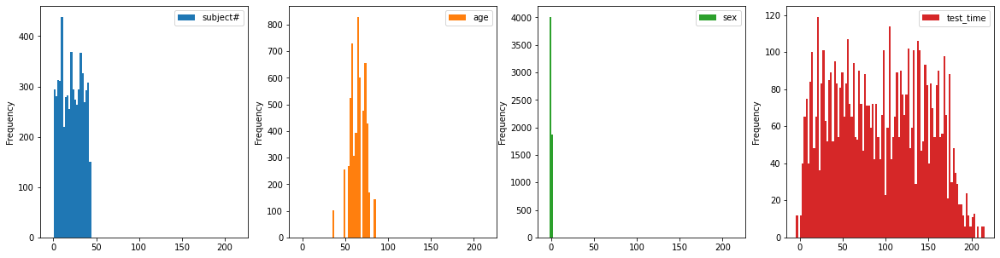

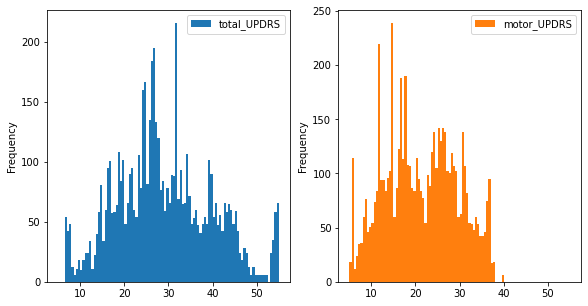

In [4]:
df[["subject#", "age", "sex", "test_time"]].plot.hist(bins=100, include_bool=True, subplots=True, layout=(1, 4), figsize=(20, 5))
df[["total_UPDRS", "motor_UPDRS"]].plot.hist(bins=100, subplots=True, layout=(1, 4), figsize=(20, 5))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f44fbcacb10>,
      dtype=object)

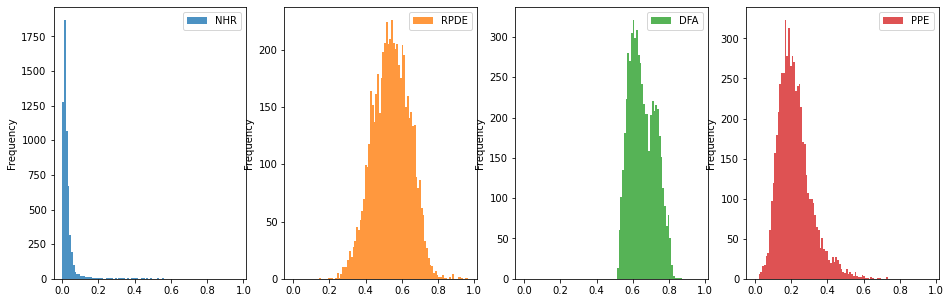

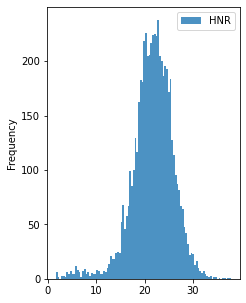

In [5]:
df[["NHR", "RPDE", "DFA", "PPE"]].plot.hist(bins=100, alpha=0.8, subplots=True, layout=(1, 5), figsize=(20, 5))
df[["HNR"]].plot.hist(bins=100, alpha=0.8, subplots=True, layout=(1, 5), figsize=(20, 5))

See all Jitter variables distribution:

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f44f9634c10>,
      dtype=object)

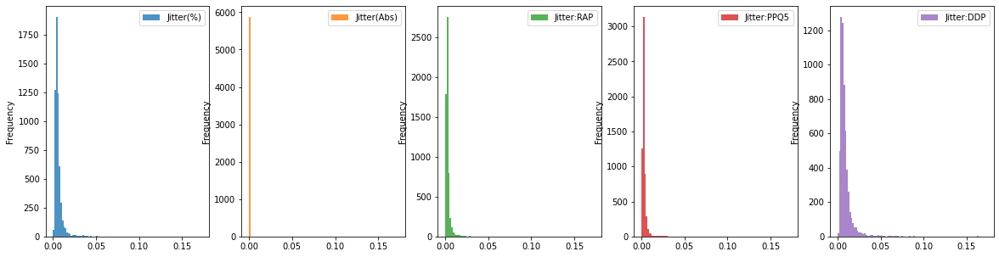

In [6]:
df[["Jitter(%)", "Jitter(Abs)", "Jitter:RAP", "Jitter:PPQ5", "Jitter:DDP"]].plot.hist(bins=100, alpha=0.8, subplots=True, layout=(1, 5), figsize=(20, 5))

See all Shimmer variables distribution:

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f44fad57f90>,
      dtype=object)

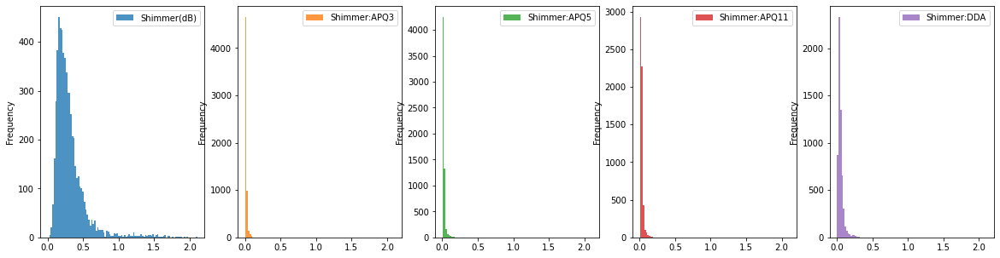

In [7]:
df[["Shimmer(dB)", "Shimmer:APQ3", "Shimmer:APQ5", "Shimmer:APQ11", "Shimmer:DDA"]].plot.hist(bins=100, alpha=0.8, subplots=True, layout=(1, 5), figsize=(20, 5))

[Pandas profiling](https://github.com/ydataai/pandas-profiling) extends the pandas DataFrame for quick data analysis.

In [8]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

from pandas_profiling import ProfileReport

profile = ProfileReport(df, title='Parkinsons Telemonitoring', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

     / 25.9 MB 711 kB/s
     |████████████████████████████████| 10.9 MB 4.0 MB/s 
     |████████████████████████████████| 596 kB 44.1 MB/s 
     |████████████████████████████████| 102 kB 11.0 MB/s 
     |████████████████████████████████| 675 kB 41.0 MB/s 
     |████████████████████████████████| 4.7 MB 41.0 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
     |████████████████████████████████| 812 kB 50.7 MB/s 
     |████████████████████████████████| 38.1 MB 1.1 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.1.1-py2.py3-none-any.whl size=261287 sha256=ec99d190e8e94c6ae4024df3761102e944b40a8246b3ced1cf3240ce38d9e984
  Stored in directory: /tmp/pip-ephem-wheel-cache-l3gjlbha/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=d445bb80604c1c9fa94dbb191e55581c977347fe18b7ba9b87f199c86d4015f6
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Working with the first patient's data

In order to get used to the data we're working on, we extract and analyse the first patient's data.

Since we're working with one person only, we can drop the subject's number, the age and the sex columns. Deleting the last two could be consider as **low variance** feature extraction.

In [9]:
# first patient sub-dataset
subject1_df = df.loc[df['subject#'] == 1]

# drop irrelevant variables
subject1_df.drop(['subject#', 'age', 'sex'], axis=1, inplace=True)
subject1_df

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,Jitter:DDP,Shimmer,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,5.6431,28.199,34.398,0.00662,0.000034,0.00401,0.00317,0.01204,0.02565,0.230,0.01438,0.01309,0.01662,0.04314,0.014290,21.640,0.41888,0.54842,0.16006
1,12.6660,28.447,34.894,0.00300,0.000017,0.00132,0.00150,0.00395,0.02024,0.179,0.00994,0.01072,0.01689,0.02982,0.011112,27.183,0.43493,0.56477,0.10810
2,19.6810,28.695,35.389,0.00481,0.000025,0.00205,0.00208,0.00616,0.01675,0.181,0.00734,0.00844,0.01458,0.02202,0.020220,23.047,0.46222,0.54405,0.21014
3,25.6470,28.905,35.810,0.00528,0.000027,0.00191,0.00264,0.00573,0.02309,0.327,0.01106,0.01265,0.01963,0.03317,0.027837,24.445,0.48730,0.57794,0.33277
4,33.6420,29.187,36.375,0.00335,0.000020,0.00093,0.00130,0.00278,0.01703,0.176,0.00679,0.00929,0.01819,0.02036,0.011625,26.126,0.47188,0.56122,0.19361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,145.6400,35.043,45.390,0.00219,0.000012,0.00104,0.00104,0.00311,0.00960,0.084,0.00471,0.00499,0.00733,0.01412,0.002408,28.183,0.40955,0.54892,0.10926
145,152.6500,35.510,46.013,0.00378,0.000020,0.00176,0.00209,0.00527,0.02038,0.232,0.01056,0.01152,0.01346,0.03169,0.013739,25.078,0.41783,0.53659,0.17886
146,159.6400,35.976,46.635,0.00237,0.000012,0.00085,0.00087,0.00256,0.01177,0.131,0.00465,0.00552,0.01070,0.01396,0.015931,28.224,0.40007,0.52887,0.13589
147,166.6400,36.443,47.257,0.00224,0.000012,0.00092,0.00082,0.00276,0.00922,0.081,0.00471,0.00466,0.00735,0.01413,0.008040,29.250,0.40794,0.54068,0.10370


We analize the base statistics description and correlation matrix of the first patient's data normalized with MinMax scaler. There we can see that there are not low variance variables.

In [11]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(subject1_df)
norm_df = pd.DataFrame(scaler.transform(subject1_df))
norm_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
0,149.0,2.563199e-16,1.003373,-1.657246,-0.823882,0.009087,0.842433,1.695916
1,149.0,-2.029696e-15,1.003373,-1.391925,-0.834017,-0.221934,0.831810,1.910760
2,149.0,-3.457339e-16,1.003373,-1.560307,-0.830052,-0.079109,0.840543,1.782362
3,149.0,-3.554204e-16,1.003373,-1.636195,-0.767116,-0.211689,0.546305,3.676297
4,149.0,1.771514e-16,1.003373,-1.678001,-0.701798,-0.122637,0.436162,3.993703
5,149.0,-9.611998e-17,1.003373,-1.318814,-0.742761,-0.212792,0.455430,2.967023
6,149.0,-9.761021e-17,1.003373,-1.428167,-0.717439,-0.187404,0.607648,4.161291
7,149.0,3.498320e-16,1.003373,-1.322292,-0.742422,-0.212474,0.451881,2.963373
8,149.0,-2.548297e-16,1.003373,-1.417787,-0.764712,-0.125671,0.387059,3.687056
9,149.0,1.289051e-16,1.003373,-1.502881,-0.760391,-0.144905,0.558507,3.372156


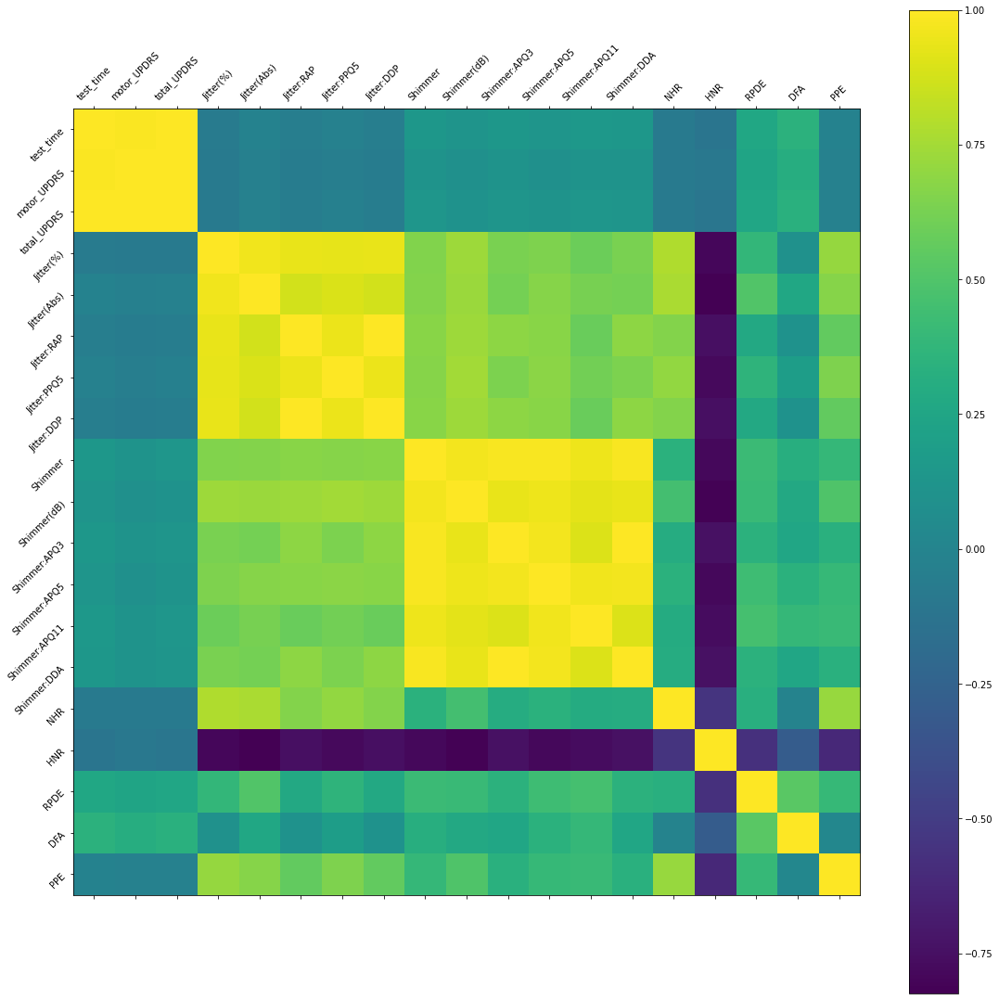

In [12]:
import matplotlib.pyplot as plt
%matplotlib inline

subject1_corr = subject1_df.corr()

# Correlation plot
f = plt.figure(figsize=subject1_corr.shape)
plt.matshow(subject1_corr, fignum=f.number)
plt.xticks(range(subject1_corr.shape[0]), subject1_corr.columns,
           fontsize=10, rotation=45)
plt.yticks(range(subject1_corr.shape[1]), subject1_corr.columns,
           fontsize=10, rotation=45)
cb = plt.colorbar()

From the correlation matrices obtained both for the first patient and the whole dataset (with pandas profiling), by visual inspection we can see that all Jitter measures are correlated with each other. Same happens with the Shimmer measures and between the `motor_UPDRS` and `total_UPDRS` variables (both target variables). We also see that the variable HNR almost has an inverse relation with the Jitter and Shimmer variables.

### Feaure selection for first patient data only

First we prepare the data for the process of feature extraction. We buid the y (target variables) and the X matrices since we are trying to find a model that will represent the relation $y=f(X)$. Then we split the dataset in both train and test sets.

In [14]:
from sklearn.model_selection import train_test_split

y = subject1_df['total_UPDRS']
X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS'], axis=1)

# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

#### Correlation feature selection
The scikit-learn machine library provides an implementation of the correlation statistic in the `f_regression()` function. This function can be used in a feature selection strategy, such as selecting the top k most relevant features (largest values) via the [SelectKBest](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html) class.

Index(['test_time', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5',
       'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['test_time', 'Shimmer', 'Shimmer:APQ3', 'Shimmer:APQ5', 'Shimmer:APQ11',
       'Shimmer:DDA', 'RPDE', 'DFA'],
      dtype='object')


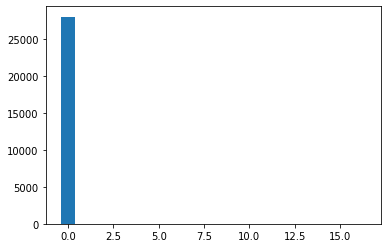

In [16]:
from sklearn.feature_selection import SelectKBest, f_regression

# configure to select k features
fs = SelectKBest(score_func=f_regression, k=8)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# plot the scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

We can see how the `test_time` variable is "the most relevant. Yet the description for the variable is:

> test_time - Time since recruitment into the trial. The integer part is the number of days since recruitment.

And that doesn't seem relevant to the result we're aiming. So we delete that feature and recalculate the k best.

Index(['Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5', 'Jitter:DDP',
       'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['Shimmer', 'Shimmer:APQ11', 'RPDE', 'DFA'], dtype='object')


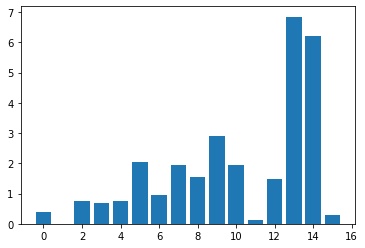

In [17]:
X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS', 'test_time'], axis=1)
# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

# configure to select k features
fs = SelectKBest(score_func=f_regression, k=4)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# plot the scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

Now we can see how relevant are the rest of variables. We can take the three most relevant that are: `DFA`,`RPDE` y `Shimmer:APQ11`.

### Mutual Information Feature Selection

Mutual information from the field of information theory is the application of information gain (typically used in the construction of decision trees) to feature selection.

Mutual information is calculated between two variables and measures the reduction in uncertainty for one variable given a known value of the other variable.

Index(['Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5', 'Jitter:DDP',
       'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11'], dtype='object')


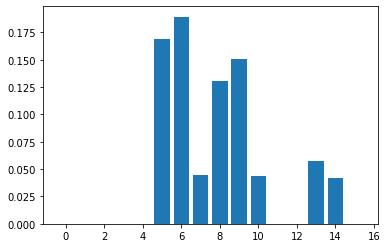

In [19]:
from sklearn.feature_selection import mutual_info_regression

# configure to select k features
fs = SelectKBest(score_func=mutual_info_regression, k=4)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

We can take the four most relevant that are: `Shimmer:APQ11`, `Shimmer:APQ5`, `Shimmer(dB)` y `Shimmer`. From the dataset info we know that they are several measures of variation in amplitude

### Normalization and training a model for first patient data only

In [20]:
y = subject1_df[['total_UPDRS']]
# all features
#X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS', 'test_time'], axis=1)
# correlation features
#X = subject1_df[['Shimmer:APQ11', 'RPDE', 'DFA']]
# mutual information features
#X = subject1_df[['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11']]
# correlation and mutual information features
#X = subject1_df[['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11', 'RPDE', 'DFA']]
# manual selection
X = subject1_df[['Jitter:DDP', 'Shimmer:APQ11', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE']]

The [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) estimator scales and translates each feature individually such that it's in the given range on the training set. The [Pipeline](https://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html) will fit the scale objects on the training data and apply the transform to new data, such as when using a model to make a prediction.

The first model will be an ordinary least squares [Linear Regression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html).

The [TransformedTargetRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.compose.TransformedTargetRegressor.html) is a meta-estimator to regress on a transformed target. Useful for applying a non-linear transformation to the target y in regression problems like this.

In [24]:
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, HuberRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import TransformedTargetRegressor

# prepare the model with input scaling
pipeline = Pipeline(steps=[('normalize', StandardScaler()), ('model', LinearRegression())])
#pipeline = Pipeline(steps=[('normalize', MinMaxScaler()), ('model', HuberRegressor())])

# prepare the model with target scaling
model = TransformedTargetRegressor(regressor=pipeline, transformer=StandardScaler())

[KFold](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.KFold.html) provides train/test indices to split data in train/test sets. Split dataset into k consecutive folds. Each fold is then used once as a validation while the k - 1 remaining folds form the training set.

Then we perform cross-validation.

Mean R2: 0.192


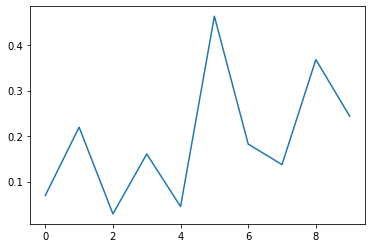

In [26]:
from sklearn.model_selection import KFold, cross_val_score
import numpy as np

# evaluate model
cv = KFold(n_splits=10, shuffle=True, random_state=1)
# scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)
# convert scores to positive
scores = np.absolute(scores)
plt.plot(scores)
# summarize the result
s_mean = np.mean(scores)
print('Mean R2: %.3f' % (s_mean))

First results are:

|Features| $R^{2}$ |
|--------|-------|
| Correlation | 0.173 | 
| Mutual information | 0.124 |
| Both | 0.207 |
| All | 0.196 |
| Manual selection | 0.192 |

## Dataset for all patients

In [27]:
y = df['total_UPDRS']
X = df.drop(['motor_UPDRS', 'total_UPDRS', 'subject#', 'test_time'], axis=1)

In [28]:
# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

## Feature selection with all patients in consideration

Now we analize if the age and sex are relevant variables for the model. 

Index(['age', 'sex', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5',
       'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['age', 'sex', 'Shimmer(dB)', 'Shimmer:APQ11', 'HNR', 'RPDE', 'DFA',
       'PPE'],
      dtype='object')


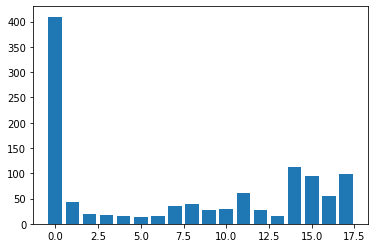

In [29]:
# configure to select all features
fs = SelectKBest(score_func=f_regression, k=8)
# learn relationship from training data
fs.fit(X_train, y_train)
# transform train input data
X_train_fs = fs.transform(X_train)
# transform test input data
X_test_fs = fs.transform(X_test)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

Index(['age', 'sex', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5',
       'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['age', 'sex'], dtype='object')


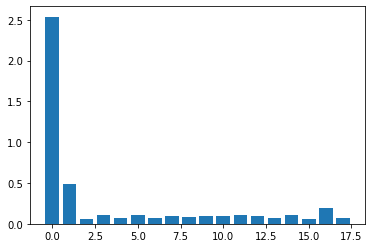

In [30]:
from sklearn.feature_selection import SelectKBest, mutual_info_regression

# configure to select all features
fs = SelectKBest(score_func=mutual_info_regression, k=2)
# learn relationship from training data
fs.fit(X_train, y_train)
# transform train input data
X_train_fs = fs.transform(X_train)
# transform test input data
X_test_fs = fs.transform(X_test)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

## Training a model for the whole dataset

In [31]:
y = df[['total_UPDRS']]
#X = df.drop(['motor_UPDRS', 'total_UPDRS'], axis=1)
X = df[['age', 'sex', 'Jitter:PPQ5', 'Shimmer:APQ11', 'HNR', 'RPDE', 'DFA', 'PPE']]
#X = df[['test_time']]

In [33]:
from sklearn.neural_network import MLPRegressor

#mod = SVR(kernel="rbf", C=100, gamma=0.1, epsilon=0.1)
mod = MLPRegressor(random_state=1, max_iter=500, hidden_layer_sizes=[100, 100], activation='tanh')
scaler = StandardScaler()

# prepare the model with input scaling
#pipeline = Pipeline(steps=[('normalize', MinMaxScaler()), ('model', LinearRegression())])
pipeline = Pipeline(steps=[('normalize', scaler), ('model', mod)])

# prepare the model with target scaling
#model = TransformedTargetRegressor(regressor=pipeline, transformer=MinMaxScaler())
model = TransformedTargetRegressor(regressor=pipeline, transformer=scaler)

# evaluate model
cv = KFold(n_splits=10, shuffle=True, random_state=1)
# scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)

Mean R2: 0.834


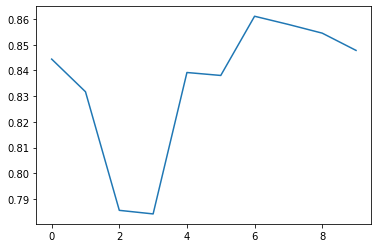

In [34]:
# convert scores to positive
scores = np.absolute(scores)
plt.plot(scores)
# summarize the result
s_mean = np.mean(scores)
print('Mean R2: %.3f' % (s_mean))

# Relevant links
- [How to Perform Feature Selection for Regression Data](https://machinelearningmastery.com/feature-selection-for-regression-data/)
- [How to Transform Target Variables for Regression in Python](https://machinelearningmastery.com/how-to-transform-target-variables-for-regression-with-scikit-learn/)